# Lab3 Data Preparation

To improve the quality of data and to adjust data to feed learning algorithms with no information loss


##  0 Profiling results and Preparation 


Starting point: issues identified in previous lab 'data profiling'

What are the needs?


###  0.1 Define needs

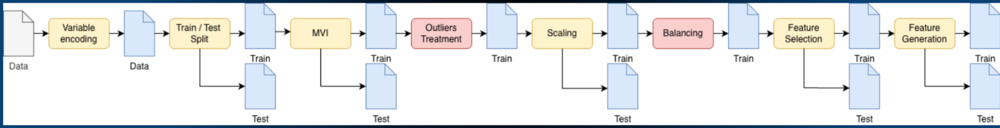


**Main idea: Evaluate data preparation techniques one by one, compare to baseline models**



For each preparation task, 

1. Pick the dataset and split it into two datasets: one for training and another for testing.
2. For each preparation task, choose two different approaches and apply them to the training
dataset. Then apply the adequate transformation to the testing set, when necessary.
3. Train a KNN and a Naïve Bayes model for each resulting dataset.
4. Compare the performance of both Naïve Bayes and both KNN models and select the dataset
that yields the best performance.
5. Pick this dataset to proceed to the next preparation task


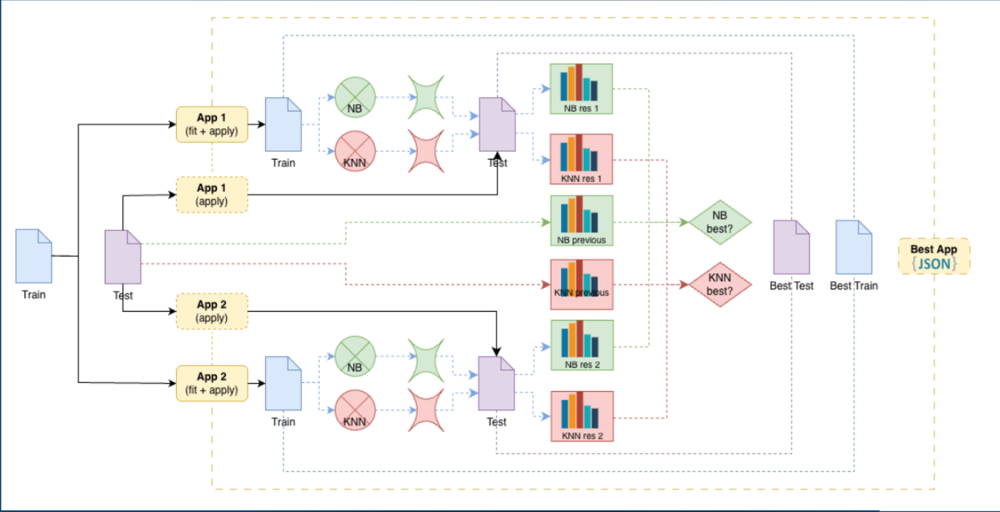


### 0.2 Load data

In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
from matplotlib.figure import Figure
import seaborn as sns
import kagglehub
from numpy import ndarray
from matplotlib.pyplot import figure, savefig, show, subplots
from sklearn.model_selection import train_test_split, ParameterGrid, StratifiedKFold
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.base import clone
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
from tqdm.auto import tqdm
import joblib

In [2]:
path = kagglehub.dataset_download("robikscube/flight-delay-dataset-20182022")
df_flights = pd.read_csv(os.path.join(path, 'Combined_Flights_2022.csv'))
df_flights.head()

,FlightDate,Airline,Origin,Dest,Cancelled,Diverted,CRSDepTime,DepTime,DepDelayMinutes,DepDelay,...,WheelsOff,WheelsOn,TaxiIn,CRSArrTime,ArrDelay,ArrDel15,ArrivalDelayGroups,ArrTimeBlk,DistanceGroup,DivAirportLandings
0,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",GJT,DEN,False,False,1133,1123.0,0.0,-10.0,...,1140.0,1220.0,8.0,1245,-17.0,0.0,-2.0,1200-1259,1,0
1,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",HRL,IAH,False,False,732,728.0,0.0,-4.0,...,744.0,839.0,9.0,849,-1.0,0.0,-1.0,0800-0859,2,0
2,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",DRO,DEN,False,False,1529,1514.0,0.0,-15.0,...,1535.0,1622.0,14.0,1639,-3.0,0.0,-1.0,1600-1659,2,0
3,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",IAH,GPT,False,False,1435,1430.0,0.0,-5.0,...,1446.0,1543.0,4.0,1605,-18.0,0.0,-2.0,1600-1659,2,0
4,2022-04-04,"Commutair Aka Champlain Enterprises, Inc.",DRO,DEN,False,False,1135,1135.0,0.0,0.0,...,1154.0,1243.0,8.0,1245,6.0,0.0,0.0,1200-1259,2,0


In [3]:
path = kagglehub.dataset_download("oktayrdeki/traffic-accidents")
df_traffic = pd.read_csv(os.path.join(path, 'Traffic_Accidents.csv'))
df_traffic.head()


,crash_date,traffic_control_device,weather_condition,lighting_condition,first_crash_type,trafficway_type,alignment,roadway_surface_cond,road_defect,crash_type,...,most_severe_injury,injuries_total,injuries_fatal,injuries_incapacitating,injuries_non_incapacitating,injuries_reported_not_evident,injuries_no_indication,crash_hour,crash_day_of_week,crash_month
0,07/29/2023 01:00:00 PM,TRAFFIC SIGNAL,CLEAR,DAYLIGHT,TURNING,NOT DIVIDED,STRAIGHT AND LEVEL,UNKNOWN,UNKNOWN,NO INJURY / DRIVE AWAY,...,NO INDICATION OF INJURY,0.0,0.0,0.0,0.0,0.0,3.0,13,7,7
1,08/13/2023 12:11:00 AM,TRAFFIC SIGNAL,CLEAR,"DARKNESS, LIGHTED ROAD",TURNING,FOUR WAY,STRAIGHT AND LEVEL,DRY,NO DEFECTS,NO INJURY / DRIVE AWAY,...,NO INDICATION OF INJURY,0.0,0.0,0.0,0.0,0.0,2.0,0,1,8
2,12/09/2021 10:30:00 AM,TRAFFIC SIGNAL,CLEAR,DAYLIGHT,REAR END,T-INTERSECTION,STRAIGHT AND LEVEL,DRY,NO DEFECTS,NO INJURY / DRIVE AWAY,...,NO INDICATION OF INJURY,0.0,0.0,0.0,0.0,0.0,3.0,10,5,12
3,08/09/2023 07:55:00 PM,TRAFFIC SIGNAL,CLEAR,DAYLIGHT,ANGLE,FOUR WAY,STRAIGHT AND LEVEL,DRY,NO DEFECTS,INJURY AND / OR TOW DUE TO CRASH,...,NONINCAPACITATING INJURY,5.0,0.0,0.0,5.0,0.0,0.0,19,4,8
4,08/19/2023 02:55:00 PM,TRAFFIC SIGNAL,CLEAR,DAYLIGHT,REAR END,T-INTERSECTION,STRAIGHT AND LEVEL,UNKNOWN,UNKNOWN,NO INJURY / DRIVE AWAY,...,NO INDICATION OF INJURY,0.0,0.0,0.0,0.0,0.0,3.0,14,7,8


## 1 Encoding

Ideas for encoding categorical variables:
- One Hot Encoding
- Label Encoding
- Target Encoding
- Frequency Encoding (better for symbolic variables)


In [7]:
print("=== Flights Dataset ===")
print(f"Shape: {df_flights.shape}")
print(f"\nData types:\n{df_flights.dtypes}")
print(f"\nNumeric columns: {df_flights.select_dtypes(include=[np.number]).columns.tolist()}")
print(f"String/Object columns: {df_flights.select_dtypes(include=['object']).columns.tolist()}")

print("\n=== Traffic Dataset ===")
print(f"Shape: {df_traffic.shape}")
print(f"\nData types:\n{df_traffic.dtypes}")
print(f"\nNumeric columns: {df_traffic.select_dtypes(include=[np.number]).columns.tolist()}")
print(f"String/Object columns: {df_traffic.select_dtypes(include=['object']).columns.tolist()}")

=== Flights Dataset ===
Shape: (4078318, 61)

Data types:
FlightDate             object
Airline                object
Origin                 object
Dest                   object
Cancelled                bool
                       ...   
ArrDel15              float64
ArrivalDelayGroups    float64
ArrTimeBlk             object
DistanceGroup           int64
DivAirportLandings      int64
Length: 61, dtype: object

Numeric columns: ['CRSDepTime', 'DepTime', 'DepDelayMinutes', 'DepDelay', 'ArrTime', 'ArrDelayMinutes', 'AirTime', 'CRSElapsedTime', 'ActualElapsedTime', 'Distance', 'Year', 'Quarter', 'Month', 'DayofMonth', 'DayOfWeek', 'DOT_ID_Marketing_Airline', 'Flight_Number_Marketing_Airline', 'DOT_ID_Operating_Airline', 'Flight_Number_Operating_Airline', 'OriginAirportID', 'OriginAirportSeqID', 'OriginCityMarketID', 'OriginStateFips', 'OriginWac', 'DestAirportID', 'DestAirportSeqID', 'DestCityMarketID', 'DestStateFips', 'DestWac', 'DepDel15', 'DepartureDelayGroups', 'TaxiOut', 'WheelsOff'

In [8]:
print("\n=== Traffic Dataset ===")
print(f"Shape: {df_traffic.shape}")
print(f"\nData types:\n{df_traffic.dtypes}")
print(f"\nNumeric columns: {df_traffic.select_dtypes(include=[np.number]).columns.tolist()}")
print(f"String/Object columns: {df_traffic.select_dtypes(include=['object']).columns.tolist()}")


=== Traffic Dataset ===
Shape: (209306, 24)

Data types:
crash_date                        object
traffic_control_device            object
weather_condition                 object
lighting_condition                object
first_crash_type                  object
trafficway_type                   object
alignment                         object
roadway_surface_cond              object
road_defect                       object
crash_type                        object
intersection_related_i            object
damage                            object
prim_contributory_cause           object
num_units                          int64
most_severe_injury                object
injuries_total                   float64
injuries_fatal                   float64
injuries_incapacitating          float64
injuries_non_incapacitating      float64
injuries_reported_not_evident    float64
injuries_no_indication           float64
crash_hour                         int64
crash_day_of_week                  int64

## 1.1 Train-test Split

In [9]:
# Define target - predicting if any injury occurred
X = df_traffic.drop(['injuries_total'], axis=1)
y = (df_traffic['injuries_total'] > 0).astype(int)

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Training set size: {X_train.shape[0]}")
print(f"Test set size: {X_test.shape[0]}\n")


Training set size: 167444
Test set size: 41862



In [12]:
# Define target - predicting if any injury occurred
X = df_flights.drop(['Cancelled'], axis=1)
y = (df_flights['Cancelled'] > 0).astype(int)

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Training set size: {X_train.shape[0]}")
print(f"Test set size: {X_test.shape[0]}\n")

Training set size: 3262654
Test set size: 815664



### 1.1 One Hot Encoding

In [ ]:
# Identify categorical columns
categorical_cols = df_flights.select_dtypes(include=['object']).columns.tolist()

# One-hot encode (minimal approach)
df_flights_1henc = pd.get_dummies(df_flights, columns=categorical_cols, drop_first=True)

In [ ]:
df_flights_1henc.head()

,Cancelled,Diverted,CRSDepTime,DepTime,DepDelayMinutes,DepDelay,ArrTime,ArrDelayMinutes,AirTime,CRSElapsedTime,...,ArrTimeBlk_1400-1459,ArrTimeBlk_1500-1559,ArrTimeBlk_1600-1659,ArrTimeBlk_1700-1759,ArrTimeBlk_1800-1859,ArrTimeBlk_1900-1959,ArrTimeBlk_2000-2059,ArrTimeBlk_2100-2159,ArrTimeBlk_2200-2259,ArrTimeBlk_2300-2359
0,False,False,1133,1123.0,0.0,-10.0,1228.0,0.0,40.0,72.0,...,False,False,False,False,False,False,False,False,False,False
1,False,False,732,728.0,0.0,-4.0,848.0,0.0,55.0,77.0,...,False,False,False,False,False,False,False,False,False,False
2,False,False,1529,1514.0,0.0,-15.0,1636.0,0.0,47.0,70.0,...,False,False,True,False,False,False,False,False,False,False
3,False,False,1435,1430.0,0.0,-5.0,1547.0,0.0,57.0,90.0,...,False,False,True,False,False,False,False,False,False,False
4,False,False,1135,1135.0,0.0,0.0,1251.0,6.0,49.0,70.0,...,False,False,False,False,False,False,False,False,False,False


In [ ]:
categorical_cols = df_traffic.select_dtypes(include=['object']).columns.tolist()

df_traffic_1henc = pd.get_dummies(df_traffic, columns=categorical_cols, drop_first=True)

In [ ]:
df_traffic_1henc.head()


,num_units,injuries_total,injuries_fatal,injuries_incapacitating,injuries_non_incapacitating,injuries_reported_not_evident,injuries_no_indication,crash_hour,crash_day_of_week,crash_month,...,prim_contributory_cause_TEXTING,prim_contributory_cause_TURNING RIGHT ON RED,prim_contributory_cause_UNABLE TO DETERMINE,prim_contributory_cause_UNDER THE INFLUENCE OF ALCOHOL/DRUGS (USE WHEN ARREST IS EFFECTED),"prim_contributory_cause_VISION OBSCURED (SIGNS, TREE LIMBS, BUILDINGS, ETC.)",prim_contributory_cause_WEATHER,most_severe_injury_INCAPACITATING INJURY,most_severe_injury_NO INDICATION OF INJURY,most_severe_injury_NONINCAPACITATING INJURY,"most_severe_injury_REPORTED, NOT EVIDENT"
0,2,0.0,0.0,0.0,0.0,0.0,3.0,13,7,7,...,False,False,True,False,False,False,False,True,False,False
1,2,0.0,0.0,0.0,0.0,0.0,2.0,0,1,8,...,False,False,False,False,False,False,False,True,False,False
2,3,0.0,0.0,0.0,0.0,0.0,3.0,10,5,12,...,False,False,False,False,False,False,False,True,False,False
3,2,5.0,0.0,0.0,5.0,0.0,0.0,19,4,8,...,False,False,True,False,False,False,False,False,True,False
4,2,0.0,0.0,0.0,0.0,0.0,3.0,14,7,8,...,False,False,False,False,False,False,False,True,False,False


### 1.2 Label Encoding

In [ ]:
# Label encoding for flight features (keep a separate label-encoded version)
df_flights_le = feature_cols.copy()

# pick only object/string columns for label encoding
categorical_cols_le = df_flights_le.select_dtypes(include=['object']).columns.tolist()

label_encoders_flights = {}
for col in categorical_cols_le:
    # ensure no NaNs for LabelEncoder and cast to str
    df_flights_le[col] = df_flights_le[col].fillna('___MISSING___').astype(str)
    le = LabelEncoder()
    df_flights_le[col] = le.fit_transform(df_flights_le[col])
    label_encoders_flights[col] = le

# Save encoders in case we need to reuse them later
joblib.dump(label_encoders_flights, "label_encoders_flights.joblib")



### 1.3 Model Training

### 1.4 Model Evaluation and Dataset Selection

## 2 Missing Value Imputation




4 options MISSING VALUES IMPUTATION Imputation
 - constant

- mean/mode value

- conditional mean value

- most probable value (with KNN in scikit-learn)


## 3 Outliers Treatment

5 options

## 4 Scaling

2 options

## 5 Balancing

3 options

## 6 Feature Selection and generation

## 7 Desired output
- Suggested charts per dataset and per preparation task:


    - Naïve Bayes and KNN performance per each approach applied
    - Identification of the best dataset and corresponding approach (best approach)
    - Naïve Bayes and KNN confusion matrices for the best approach

